In [1]:
import pickle
import os
from notebook_utils import plot_dendogram_and_tsne, explain_predictions
import sys
sys.path.append('..')
from utils import get_texts, Tokenizer, DataGenerator, lstm_model
from log import logger

%load_ext autoreload
%autoreload 2

matplotlib.pyplot - DEBUG - Loaded backend module://ipykernel.pylab.backend_inline version unknown.


# Get Hiddens

In [2]:
main_dir = '..'
feature_type = 'verbal_stem'
character_level = False
language = 'hebrew'
seq_len = 32
batch_size = 1
lstm_dim = 256
domain = 'Q'

In [3]:
!ls ../data/hidden_states

clause_type_hebrew_lstm_256_seq_len_32.pkl
clause_type_hebrew_lstm_256_seq_len_32_N.pkl
clause_type_hebrew_lstm_256_seq_len_32_Q.pkl
phrase_function_hebrew_lstm_256_seq_len_14_N.pkl
phrase_function_hebrew_lstm_256_seq_len_32.pkl
phrase_function_hebrew_lstm_256_seq_len_32_N.pkl
phrase_function_hebrew_lstm_256_seq_len_32_Q.pkl
verbal_stem_hebrew_lstm_256_seq_len_32.pkl
verbal_stem_hebrew_lstm_256_seq_len_32_N.pkl
verbal_stem_hebrew_lstm_256_seq_len_32_Q.pkl
verbal_stem_hebrew_lstm_256_seq_len_8_N.pkl
word_english_lstm_512_seq_len_32.pkl
word_hebrew_lstm_512_seq_len_32.pkl
word_number_hebrew_lstm_256_seq_len_32.pkl
word_number_hebrew_lstm_256_seq_len_32_N.pkl
word_number_hebrew_lstm_256_seq_len_32_Q.pkl
word_pos_hebrew_lstm_256_seq_len_32.pkl
word_pos_hebrew_lstm_256_seq_len_32_N.pkl
word_pos_hebrew_lstm_256_seq_len_32_Q.pkl


In [4]:
path = os.path.join('..', 'data', 'hidden_states', f'{feature_type}_{language}_lstm_{lstm_dim}_seq_len_{seq_len}_{domain}.pkl')

with open(path, 'rb') as f:
    hiddens = pickle.load(f)
    
    
    
path = os.path.join('..', 'data', 'predictions', f'{feature_type}_{language}_lstm_{lstm_dim}_seq_len_{seq_len}_{domain}.pkl')

with open(path, 'rb') as f:
    predictions = pickle.load(f)

Variance PCA: 0.9601269960403442


matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.font_manager - DEBUG - findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0 to DejaVu Sans ('/Users/david/miniconda2/envs/py36/lib/python3.6/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf') with score of 0.050000.
matplotlib.font_manager - DEBUG - findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=12.0 to DejaVu Sans ('/Users/david/miniconda2/envs/py36/lib/python3.6/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans.ttf') with score of 0.050000.
matplotlib.font_manager - DEBUG - findfont: Matching :family=sans-serif:style=normal:variant=normal:weight=bold:stretch=normal:size=14.0 to DejaVu Sans ('/Users/david/miniconda2/envs/py36/lib/python3.6/site-packages/matplotlib/mpl-data/fonts/ttf/DejaVuSans-Bold.ttf') with score of 0.000000.
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - 

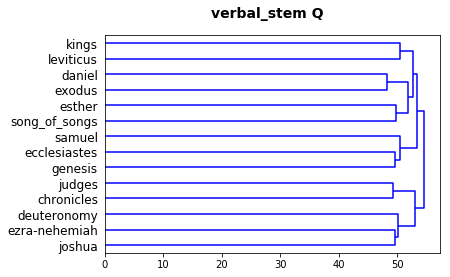

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 896 samples in 0.004s...
[t-SNE] Computed neighbors for 896 samples in 0.251s...
[t-SNE] Computed conditional probabilities for sample 896 / 896
[t-SNE] Mean sigma: 1.859029
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.863400
[t-SNE] KL divergence after 1000 iterations: 0.525101


matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


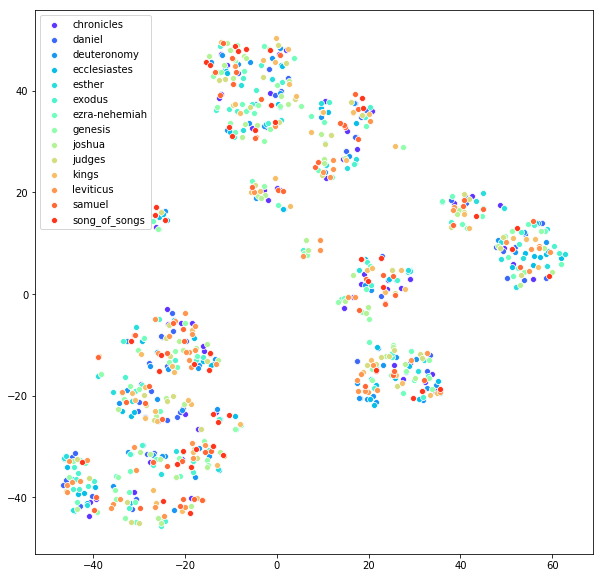

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


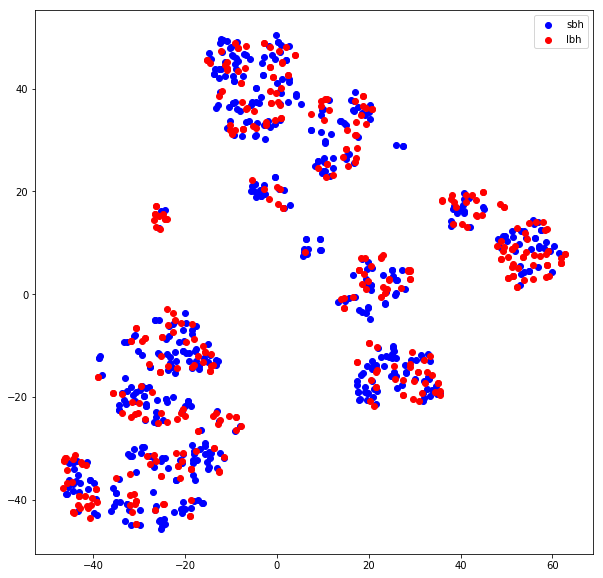

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


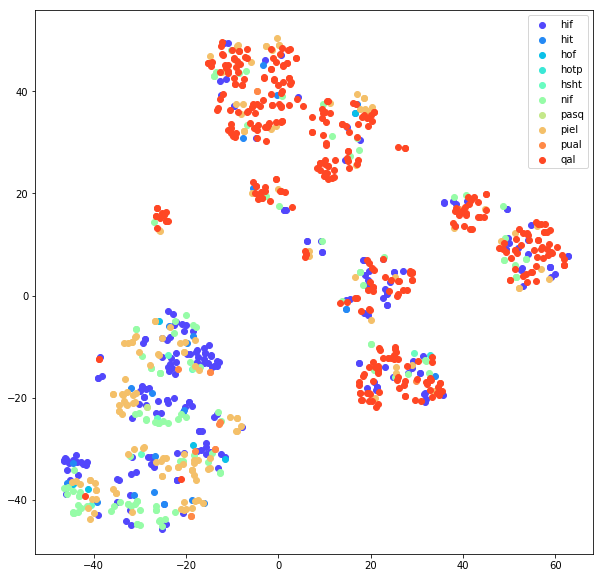

matplotlib.axes._base - DEBUG - update_title_pos


chronicles
daniel
deuteronomy
ecclesiastes
esther
exodus
ezra-nehemiah
genesis
joshua
judges
kings
leviticus
samuel
song_of_songs


matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


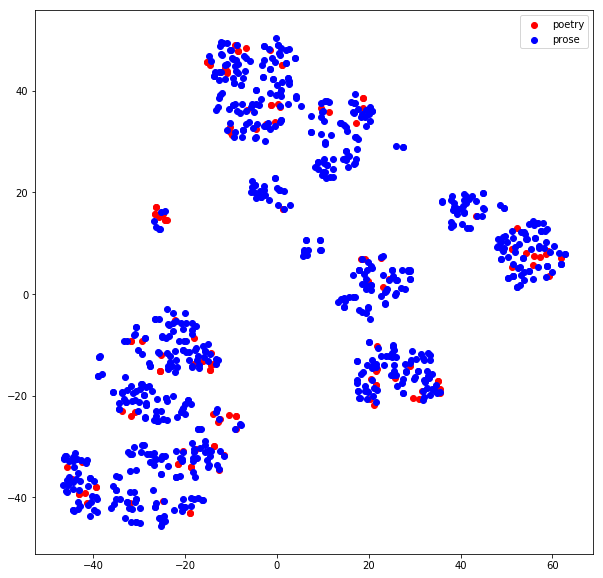

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


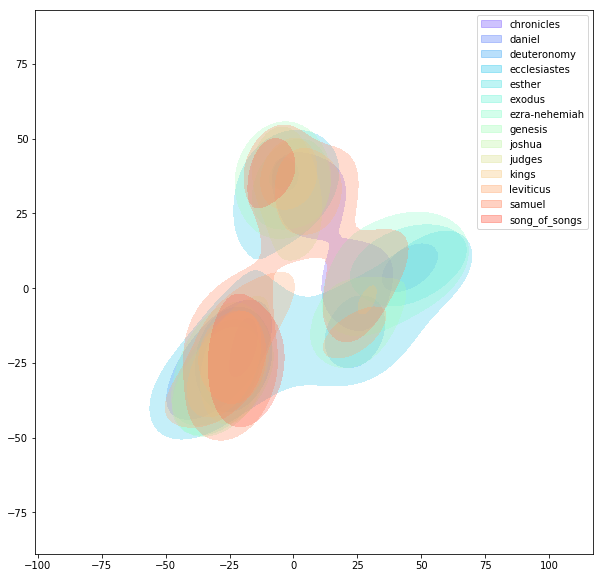

matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos
matplotlib.axes._base - DEBUG - update_title_pos


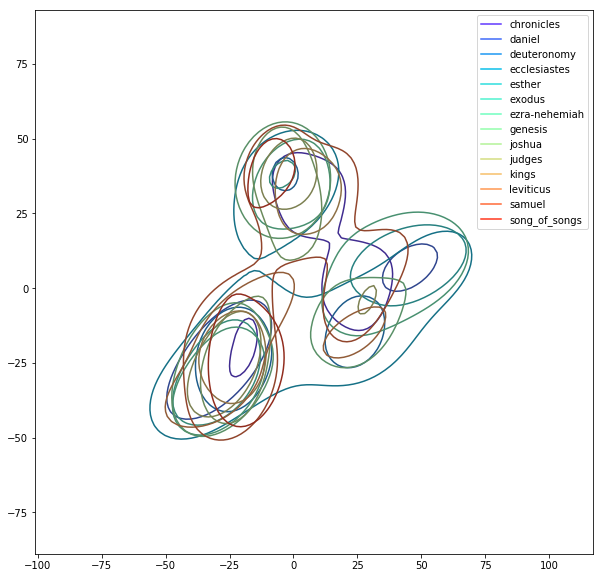

In [5]:
plot_dendogram_and_tsne(hiddens, f'{feature_type} {domain}', predictions=predictions, pca_components=128)

# Explain Predictions

In [6]:



texts = get_texts(main_dir, language, feature_type, character_level, domain=domain)
tokenizer = Tokenizer(texts.values(), character_level=character_level)
test_generator = DataGenerator(tokenizer,
                               tokenizer.full_text,
                               seq_len=seq_len,
                               batch_size=batch_size,
                               with_embedding=True,
                               train=False)



file_path = os.path.join(main_dir, 'models',
                         f'{feature_type}_{language}_lstm_{lstm_dim}')

if domain:
    file_path += f'_{domain}'

if character_level:
    file_path += '_character_level'

file_path += '.h5'

logger.info(f"Loading {file_path}")

prediction_model = lstm_model(num_words=tokenizer.num_words,
                              lstm_dim=lstm_dim,
                              seq_len=1,
                              batch_size=batch_size,
                              stateful=True,
                              return_state=False,
                              flatten=True)

prediction_model.load_weights(file_path)


root - INFO - Full text sample: piel hif qal hit hif hif hif hif
root - INFO - Length of tokenizer: 22
root - INFO - Setting up testing generator...
root - INFO - Length of encoded texts: 7845
root - INFO - Number of sequences: 1562
root - INFO - Loading ../models/verbal_stem_hebrew_lstm_256_Q.h5


Instructions for updating:
Colocations handled automatically by placer.


tensorflow - WARNING - From /Users/david/miniconda2/envs/py36/lib/python3.6/site-packages/tensorflow/python/ops/resource_variable_ops.py:435: colocate_with (from tensorflow.python.framework.ops) is deprecated and will be removed in a future version.
Instructions for updating:
Colocations handled automatically by placer.


In [7]:
file_name = f'{feature_type}_{language}_lstm_{lstm_dim}_seq_len_{seq_len}'

if domain:
    file_name += f'_{domain}'

if character_level:
    file_name += '_character-level'
file_name += '.pkl'


seeds_path = os.path.join(main_dir, 'data', 'seeds', file_name)

with open(seeds_path, 'rb') as f:
    seeds = pickle.load(f)

In [8]:
explain_predictions(seeds, prediction_model, tokenizer)



------------------------------

Explanations for chronicles


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for daniel


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for deuteronomy


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for ecclesiastes


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for esther


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for exodus


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for ezra-nehemiah


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for genesis


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for joshua


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for judges


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for kings


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for leviticus


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for samuel


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)




------------------------------

Explanations for song_of_songs


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)


/Users/david/miniconda2/envs/py36/lib/python3.6/re.py:212: FutureWarning: split() requires a non-empty pattern match.
  return _compile(pattern, flags).split(string, maxsplit)
